In [1]:
%matplotlib inline

%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'

In [2]:
from mle_toolbox import load_result_logs
from mle_logging import load_log
from mle_toolbox.utils import load_pkl_object

import matplotlib.pyplot as plt
import numpy as np

import matplotlib as mpl
mpl.rcParams['figure.dpi']= 300
import seaborn as sns
#sns.set_style('whitegrid')

base_palette = sns.color_palette()

<frozen importlib._bootstrap>:228: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


# MNIST - SGD & ARS

In [3]:
log = load_pkl_object("../experiments/connect/extra/connect_barriers.pkl")
log_mean = log.mean(axis=0)
log_mean.shape

(30, 30, 11)

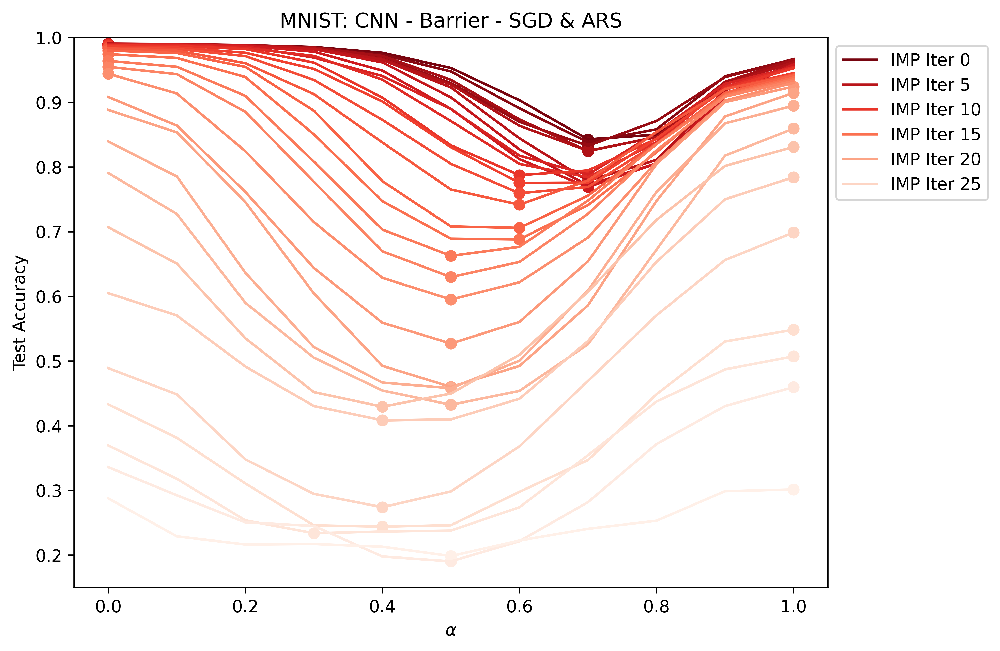

In [4]:
sns.set_palette(sns.color_palette("Reds_r", n_colors=30))

fig, ax = plt.subplots(figsize=(8, 6))
alphas = np.linspace(0, 1, 11)

for i in range(30):
    if (i) % 5 == 0 or i == 0:
        ax.plot(alphas, log_mean[i, i], label=f"IMP Iter {i}")
    else:
        ax.plot(alphas, log_mean[i, i])
    min_barrier_id = log_mean[i, i].argmin()
    max_barrier_id = log_mean[i, i].argmax()
    ax.scatter([alphas[min_barrier_id], alphas[max_barrier_id]],
    [log_mean[i, i][min_barrier_id], log_mean[i, i][max_barrier_id]])

ax.set_ylim(0.15, 1.0)
ax.set_xlabel(r"$\alpha$")
ax.set_ylabel("Test Accuracy")
ax.set_title("MNIST: CNN - Barrier - SGD & ARS")
ax.legend(bbox_to_anchor=(1.0, 1.0))
sns.set_palette(base_palette)


In [5]:
barrier = []
barrier_sgd = []
barrier_es = []
for i in range(29):
    max_err = log_mean[i, i].max() - log_mean[i, i].min()
    sgd_err = log_mean[i, i][0] - log_mean[i, i].min()
    es_err = log_mean[i, i][-1] - log_mean[i, i].min()
    barrier.append(max_err)
    barrier_sgd.append(sgd_err)
    barrier_es.append(es_err)

Text(0.5, 1.0, 'Max. Error Increase Over Linear Path & Sparsities')

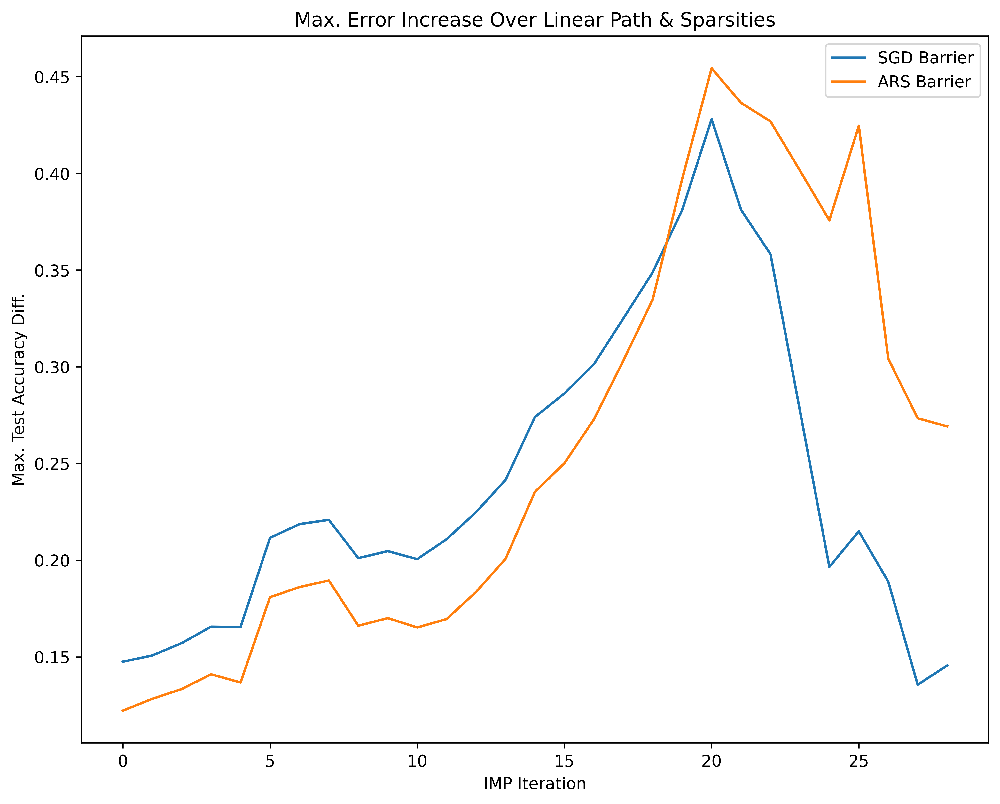

In [6]:
fig, ax = plt.subplots(figsize=(10, 8))

#ax.plot(barrier, label="Max. Barrier")
ax.plot(barrier_sgd, label="SGD Barrier")
ax.plot(barrier_es, label="ARS Barrier")
ax.legend()

ax.set_xlabel("IMP Iteration")
ax.set_ylabel("Max. Test Accuracy Diff.")
ax.set_title("Max. Error Increase Over Linear Path & Sparsities")

In [23]:
from mle_toolbox.visualize import plot_2D_heatmap

log = load_pkl_object("../experiments/mnist/connect/extra/connect_sgd_es.pkl")
log_mean = log.mean(axis=0)

max_err = log_mean.max(axis=2) - log_mean.min(axis=2)
range_x = np.arange(30)
range_y = np.arange(30)[::-1]


from matplotlib.gridspec import GridSpec

fig = plt.figure(figsize=(20, 20))
gs = GridSpec(3, 3)

ax_heat = fig.add_subplot(gs[1:3, 0:2])
ax_x = fig.add_subplot(gs[0,0:2])
ax_y = fig.add_subplot(gs[1:3, 2])

plot_2D_heatmap(range_x, range_y, max_err, cmap="magma_r",
                round_ticks=0, every_nth_tick=5,
                title="MNIST-CNN: SGD-ARS Mode Barrier",
                xy_labels=["SGD IMP Iteration", "ARS IMP Iteration"],
                variable_name="Max. Barrier - Error Increase",
                max_heat=0.75, min_heat=0.,
                fig=fig, ax=ax_heat)

ax_x.plot(np.arange(30), np.arange(30))
ax_y.plot(np.arange(30), np.arange(30))
fig.tight_layout()

(<Figure size 3000x2400 with 2 Axes>,
 <Axes: title={'center': 'MNIST-CNN: SGD-SGD Barrier'}, xlabel='SGD IMP Iteration', ylabel='SGD IMP Iteration'>)

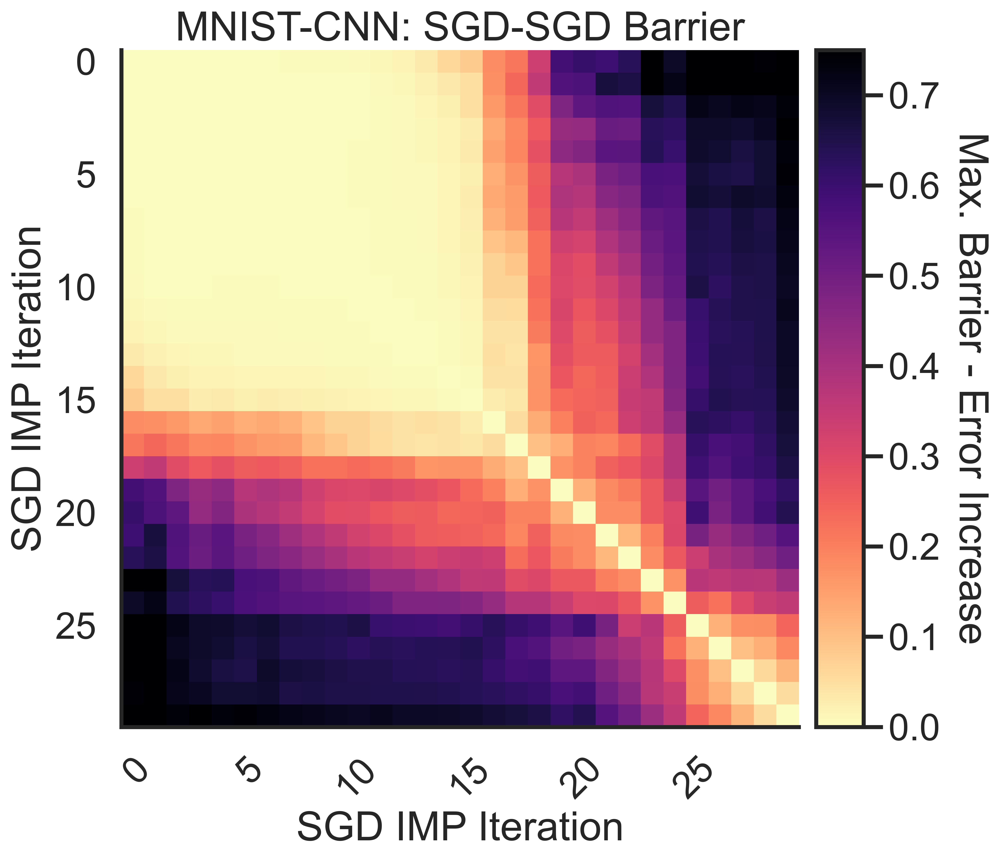

In [8]:

from mle_toolbox.visualize import plot_2D_heatmap

log = load_pkl_object("../experiments/connect/extra/connect_sgd_sgd.pkl")
log_mean = log.mean(axis=0)

max_err = log_mean.max(axis=2) - log_mean.min(axis=2)
range_x = np.arange(30)
range_y = np.arange(30)[::-1]

plot_2D_heatmap(range_x, range_y, max_err, cmap="magma_r",
                round_ticks=0, every_nth_tick=5,
                title="MNIST-CNN: SGD-SGD Barrier",
                xy_labels=["SGD IMP Iteration", "SGD IMP Iteration"],
                variable_name="Max. Barrier - Error Increase",
                max_heat=0.75, min_heat=0.)

(<Figure size 3000x2400 with 2 Axes>,
 <Axes: title={'center': 'MNIST-CNN: ARS-ARS Barrier'}, xlabel='ARS IMP Iteration', ylabel='ARS IMP Iteration'>)

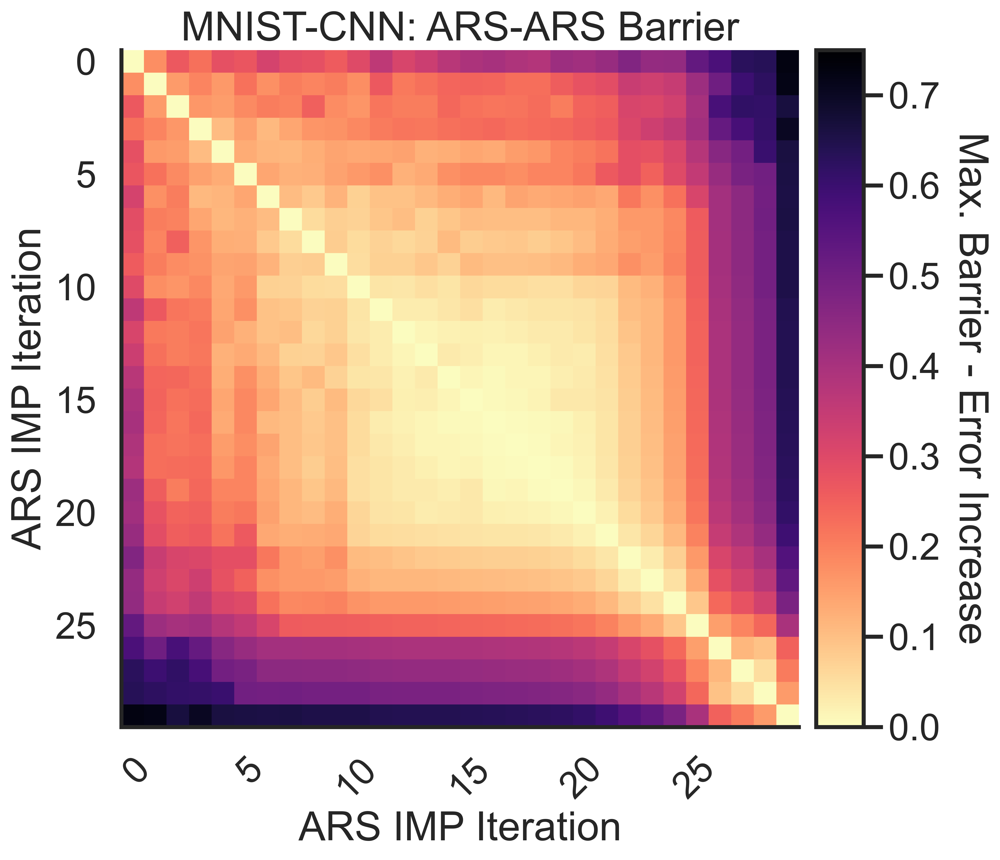

In [9]:

from mle_toolbox.visualize import plot_2D_heatmap

log = load_pkl_object("../experiments/connect/extra/connect_es_es.pkl")
log_mean = log.mean(axis=0)

max_err = log_mean.max(axis=2) - log_mean.min(axis=2)
range_x = np.arange(30)
range_y = np.arange(30)[::-1]

plot_2D_heatmap(range_x, range_y, max_err, cmap="magma_r",
                round_ticks=0, every_nth_tick=5,
                title="MNIST-CNN: ARS-ARS Barrier",
                xy_labels=["ARS IMP Iteration", "ARS IMP Iteration"],
                variable_name="Max. Barrier - Error Increase",
                max_heat=0.75, min_heat=0.)

# Random Projections - 2D Loss Surface MNIST

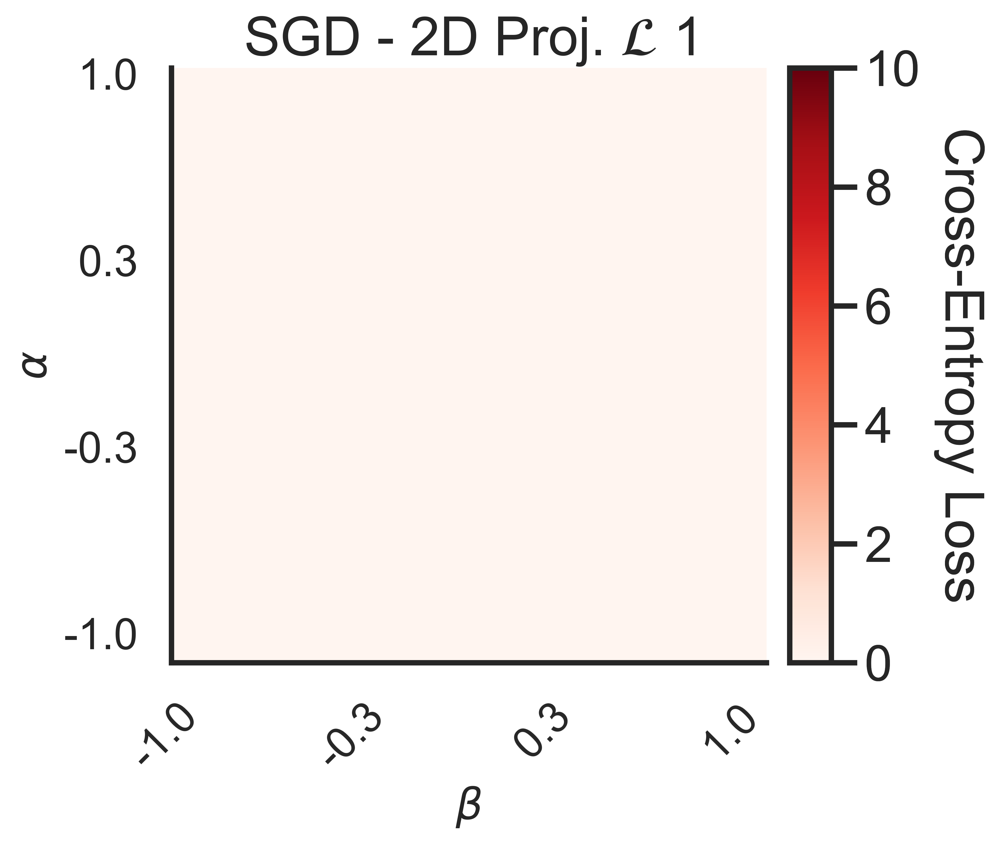

In [13]:
log_sgd = load_pkl_object("../experiments/mnist_project_fixed/extra/project_sgd_sgd.pkl")

range_x = np.linspace(-1, 1, 50)
range_y = np.linspace(-1, 1, 50)

from mle_toolbox.visualize import animate_2D_grid
animate_2D_grid(
    data=-log_sgd.mean(axis=0),
    var_name="Cross-Entropy Loss",
    dt=1,
    ylabel=r"$\alpha$",
    xlabel=r"$\beta$",
    range_y=range_y,
    range_x=range_x,
    every_nth=4,
    round_ticks=1,
    vmin=0,
    vmax=10,
    title=r"SGD - 2D Proj. $\mathcal{L}$",
    time_pre_str="",
    interval=100,
    fps=60,
    fname="anim_sgd_loss.gif",
    direct_save=True,
    no_axis_ticks=False,
    cmap="Reds",
    interpolation="spline16"
)

<a list of 23 text.Text objects>

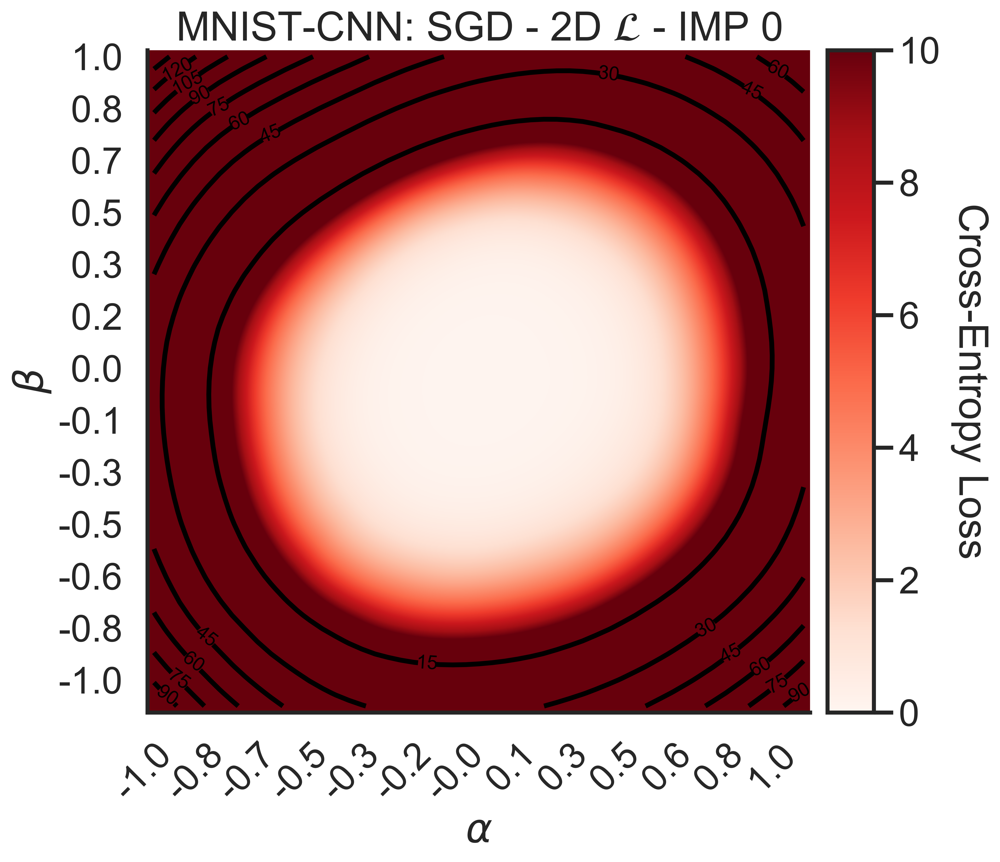

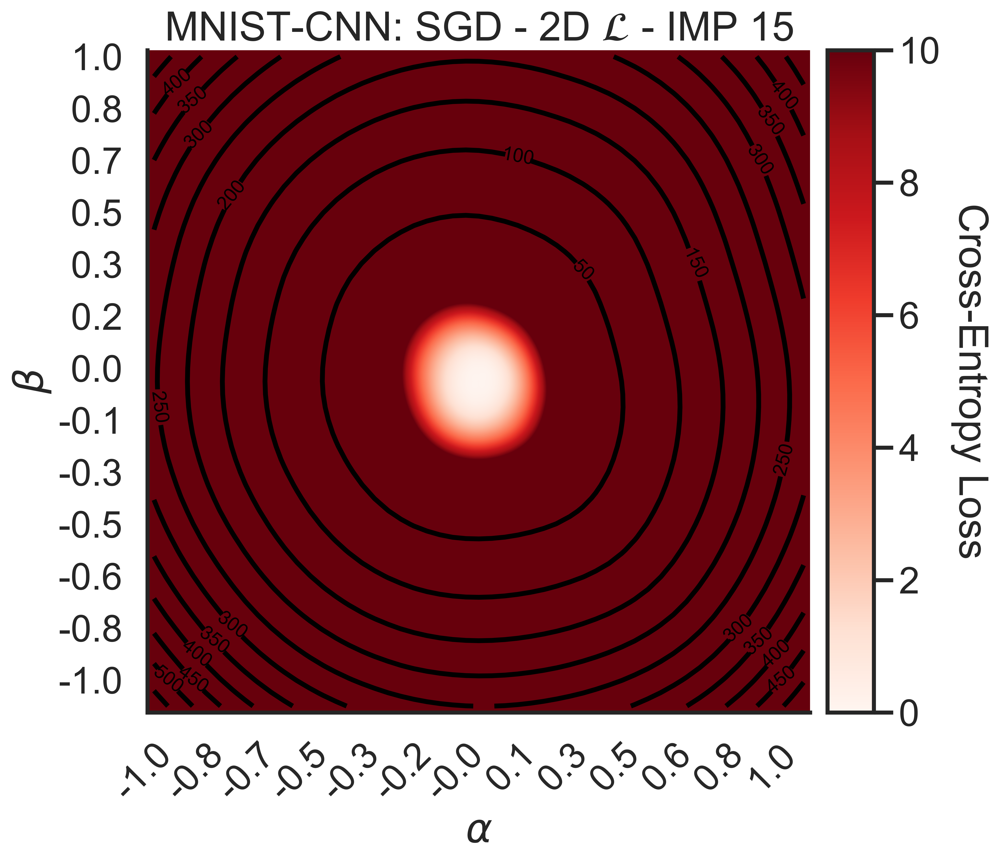

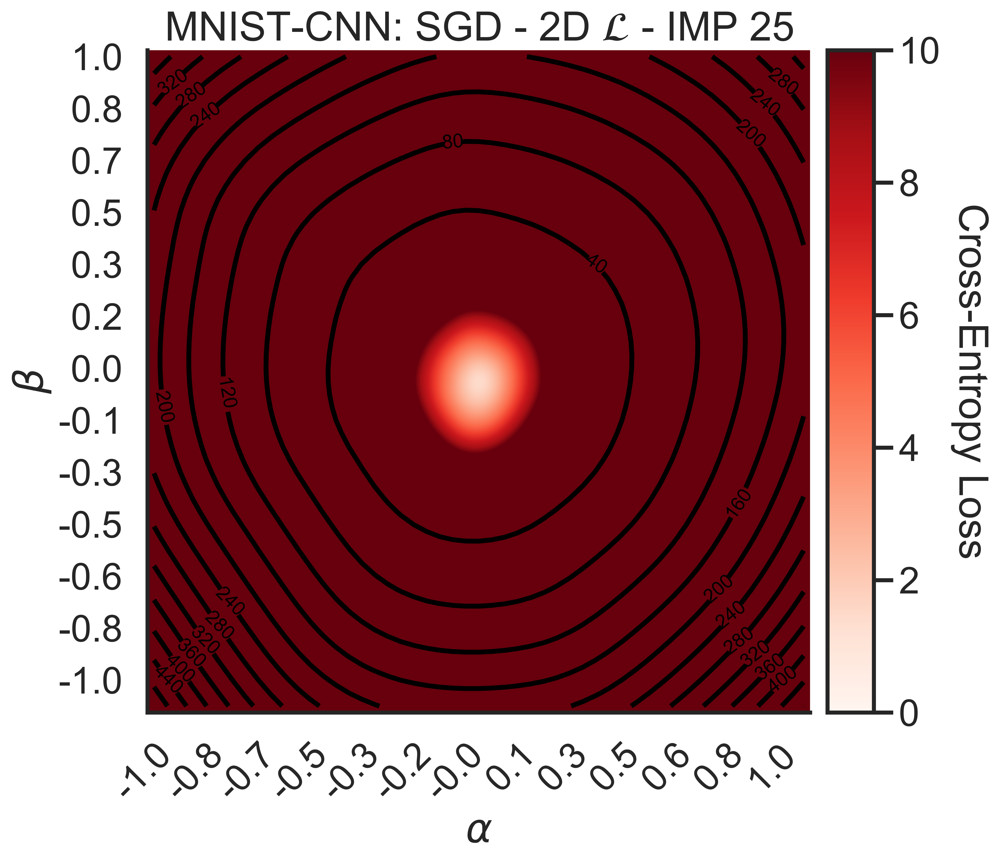

In [14]:
fig, ax = plot_2D_heatmap(range_x, range_y, -log_sgd.mean(axis=0)[0], cmap="Reds",
                            round_ticks=1, every_nth_tick=4,
                            title=r"MNIST-CNN: SGD - 2D $\mathcal{L}$ - IMP 0",
                            xy_labels=[r"$\alpha$", r"$\beta$"],
                            variable_name="Cross-Entropy Loss",
                            max_heat=10, min_heat=0.,
                            interpolation="spline16")
cont = ax.contour(-log_sgd.mean(axis=0)[0], colors="black", levels=12)
cont.clabel(inline=True, fontsize=12)

fig, ax = plot_2D_heatmap(range_x, range_y, -log_sgd.mean(axis=0)[15], cmap="Reds",
                            round_ticks=1, every_nth_tick=4,
                            title=r"MNIST-CNN: SGD - 2D $\mathcal{L}$ - IMP 15",
                            xy_labels=[r"$\alpha$", r"$\beta$"],
                            variable_name="Cross-Entropy Loss",
                            max_heat=10, min_heat=0.,
                            interpolation="spline16")
cont = ax.contour(-log_sgd.mean(axis=0)[15], colors="black", levels=12)
cont.clabel(inline=True, fontsize=12)

fig, ax = plot_2D_heatmap(range_x, range_y, -log_sgd.mean(axis=0)[25], cmap="Reds",
                            round_ticks=1, every_nth_tick=4,
                            title=r"MNIST-CNN: SGD - 2D $\mathcal{L}$ - IMP 25",
                            xy_labels=[r"$\alpha$", r"$\beta$"],
                            variable_name="Cross-Entropy Loss",
                            max_heat=10, min_heat=0.,
                            interpolation="spline16")
cont = ax.contour(-log_sgd.mean(axis=0)[25], colors="black", levels=12)
cont.clabel(inline=True, fontsize=12)

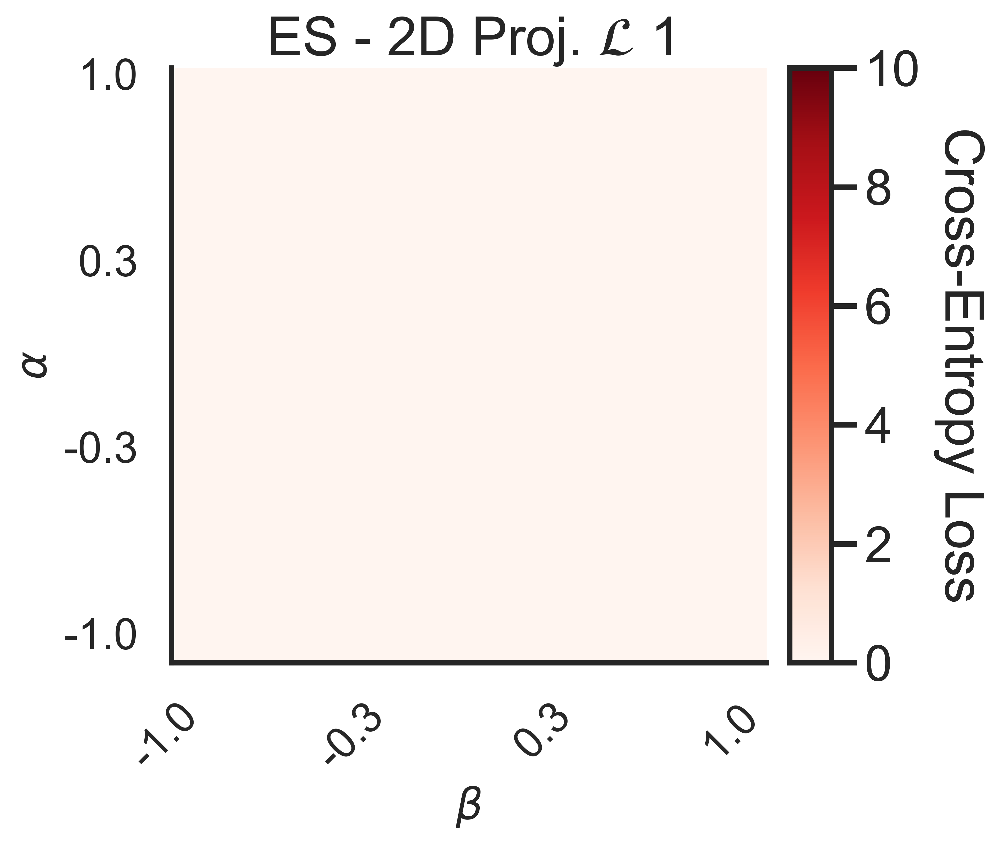

In [17]:
log_es = load_pkl_object("../experiments/mnist_project_fixed/extra/project_es_es.pkl")

animate_2D_grid(
    data=-log_es.mean(axis=0),
    var_name="Cross-Entropy Loss",
    dt=1,
    ylabel=r"$\alpha$",
    xlabel=r"$\beta$",
    range_y=range_y,
    range_x=range_x,
    every_nth=4,
    round_ticks=1,
    vmin=0,
    vmax=10,
    title=r"ES - 2D Proj. $\mathcal{L}$",
    time_pre_str="",
    interval=100,
    fps=60,
    fname="anim_es_loss.gif",
    direct_save=True,
    no_axis_ticks=False,
    cmap="Reds",
    interpolation="spline16"
)

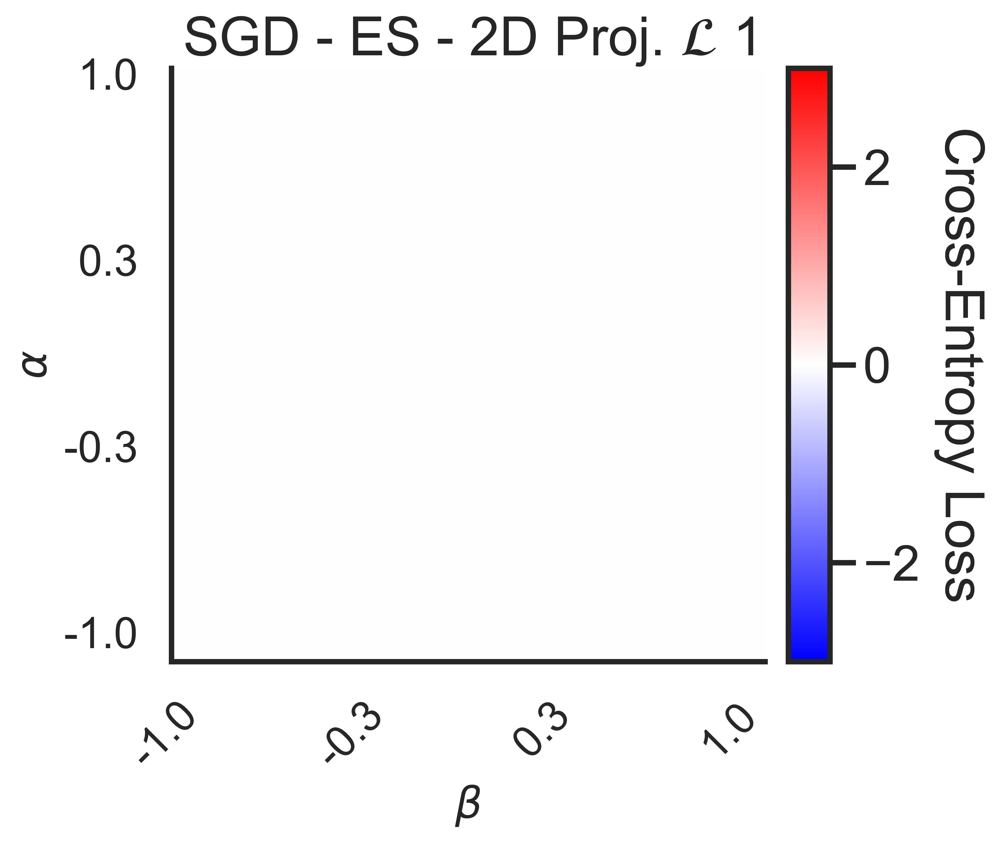

In [18]:
animate_2D_grid(
    data=-log_sgd.mean(axis=0) + log_es.mean(axis=0),
    var_name="Cross-Entropy Loss",
    dt=1,
    ylabel=r"$\alpha$",
    xlabel=r"$\beta$",
    range_y=range_y,
    range_x=range_x,
    every_nth=4,
    round_ticks=1,
    vmin=-3,
    vmax=3,
    title=r"SGD - ES - 2D Proj. $\mathcal{L}$",
    time_pre_str="",
    interval=100,
    fps=60,
    fname="anim_diff_loss.gif",
    direct_save=True,
    no_axis_ticks=False,
    cmap="bwr",
    interpolation="spline16"
)

<a list of 16 text.Text objects>

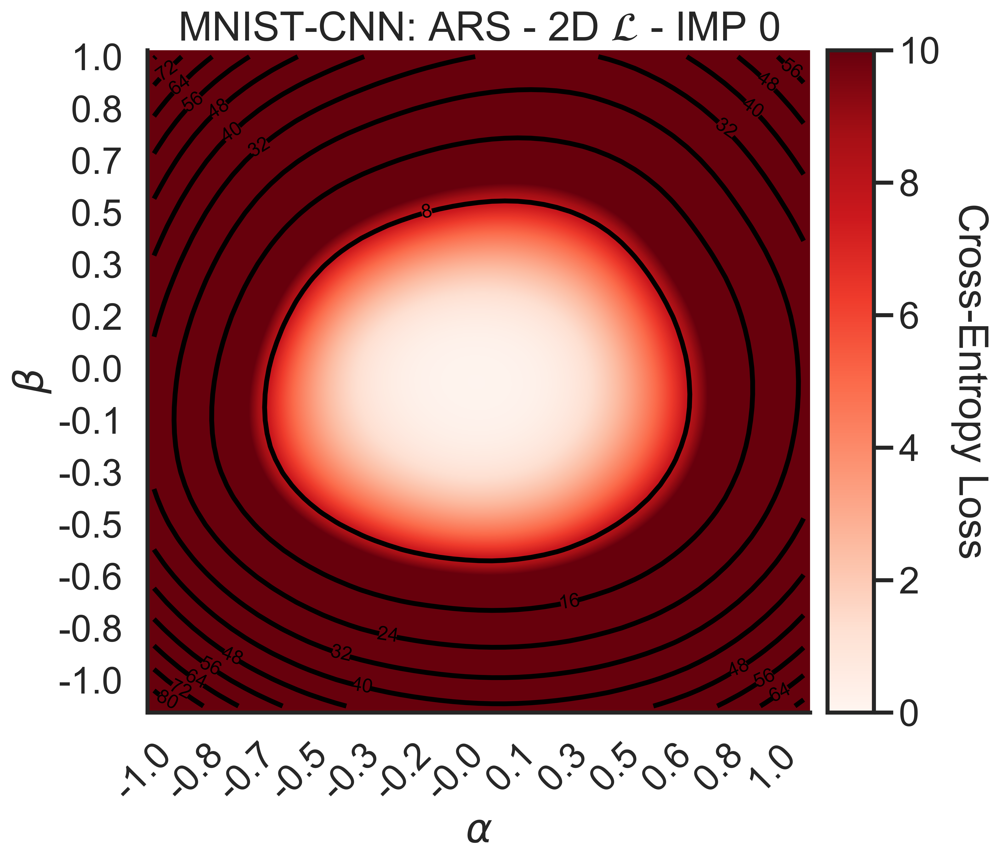

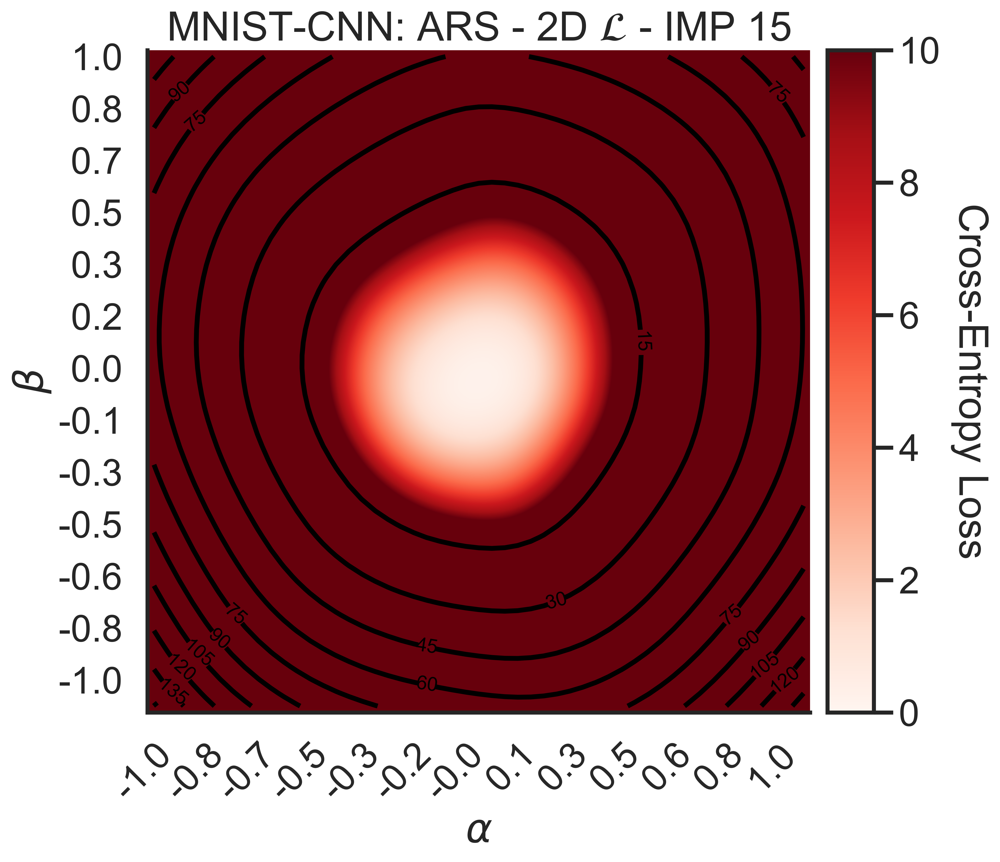

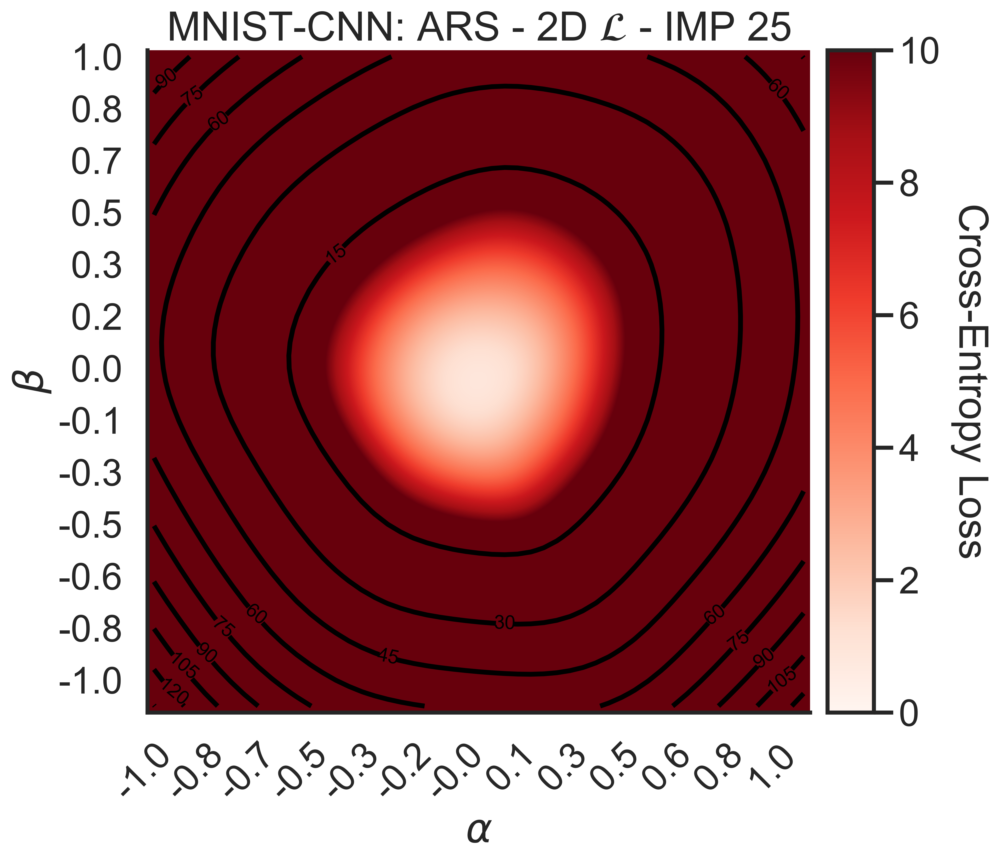

In [19]:
fig, ax = plot_2D_heatmap(range_x, range_y, -log_es.mean(axis=0)[0], cmap="Reds",
                            round_ticks=1, every_nth_tick=4,
                            title=r"MNIST-CNN: ARS - 2D $\mathcal{L}$ - IMP 0",
                            xy_labels=[r"$\alpha$", r"$\beta$"],
                            variable_name="Cross-Entropy Loss",
                            max_heat=10, min_heat=0.,
                            interpolation="spline16")
cont = ax.contour(-log_es.mean(axis=0)[0], colors="black", levels=12)
cont.clabel(inline=True, fontsize=12)

fig, ax = plot_2D_heatmap(range_x, range_y, -log_es.mean(axis=0)[15], cmap="Reds",
                            round_ticks=1, every_nth_tick=4,
                            title=r"MNIST-CNN: ARS - 2D $\mathcal{L}$ - IMP 15",
                            xy_labels=[r"$\alpha$", r"$\beta$"],
                            variable_name="Cross-Entropy Loss",
                            max_heat=10, min_heat=0.,
                            interpolation="spline16")
cont = ax.contour(-log_es.mean(axis=0)[15], colors="black", levels=12)
cont.clabel(inline=True, fontsize=12)

fig, ax = plot_2D_heatmap(range_x, range_y, -log_es.mean(axis=0)[25], cmap="Reds",
                            round_ticks=1, every_nth_tick=4,
                            title=r"MNIST-CNN: ARS - 2D $\mathcal{L}$ - IMP 25",
                            xy_labels=[r"$\alpha$", r"$\beta$"],
                            variable_name="Cross-Entropy Loss",
                            max_heat=10, min_heat=0.,
                            interpolation="spline16")
cont = ax.contour(-log_es.mean(axis=0)[25], colors="black", levels=12)
cont.clabel(inline=True, fontsize=12)

# Regression - Sharpness

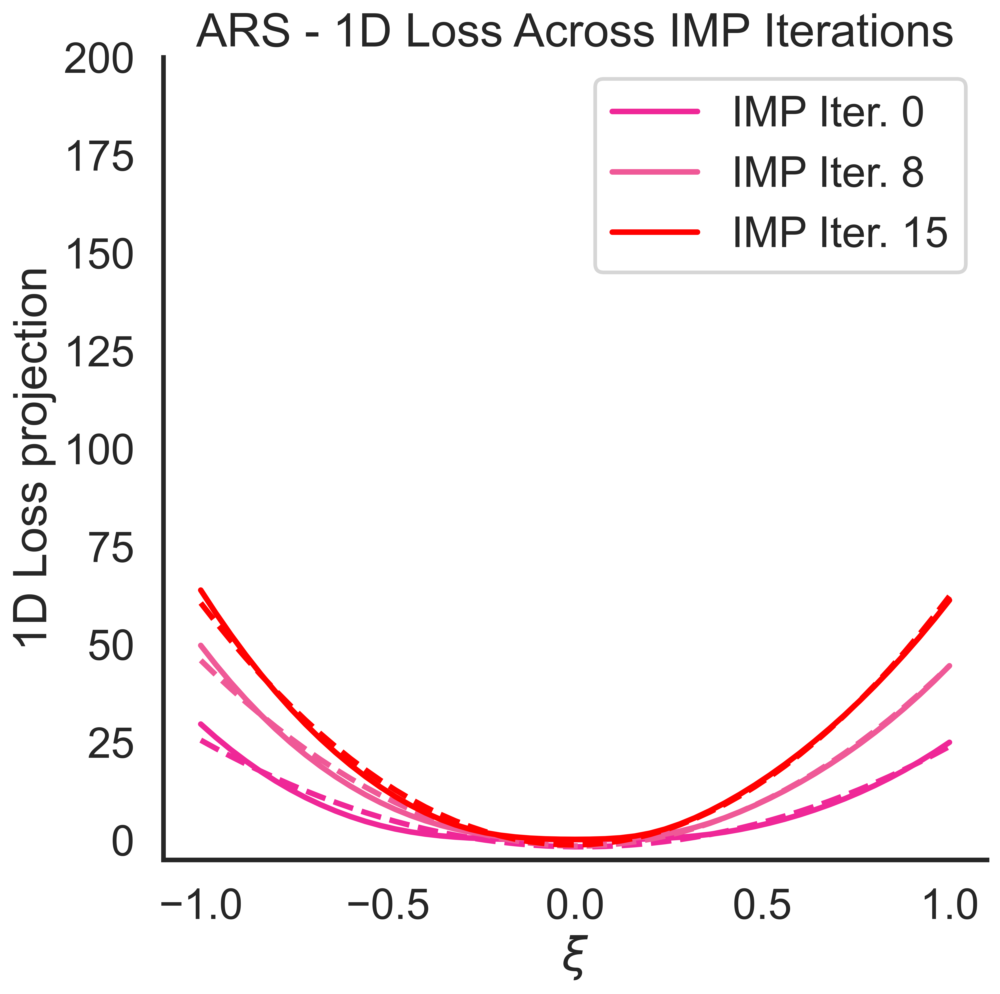

In [21]:
log_es = load_pkl_object("../experiments/mnist_project_fixed/extra/project_es_es.pkl")

xi = np.linspace(-1, 1, 51)
mid_point = 25

fig, ax = plt.subplots(figsize=(8, 8))
col_es = [(239/255, 39/255, 151/255), (239/255, 89/255, 151/255), "red",]

counter = 0
for i in [0, 8, 15]:
    ax.plot(xi, -log_es.mean(axis=0)[i, mid_point], label=f"IMP Iter. {i}", c=col_es[counter])
    y = -log_es.mean(axis=0)[i, mid_point]
    coeffs = np.polyfit(xi, y, deg=2)
    fit = coeffs[0] * xi**2 + coeffs[1] * xi + coeffs[2]
    ax.plot(xi, fit, ls="--", c=col_es[counter])
    counter += 1


ax.legend()
ax.set_ylim(-5, 200)
ax.set_xlabel(r"$\xi$")
ax.set_ylabel(r"1D Loss projection")
ax.set_title("ARS - 1D Loss Across IMP Iterations")
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

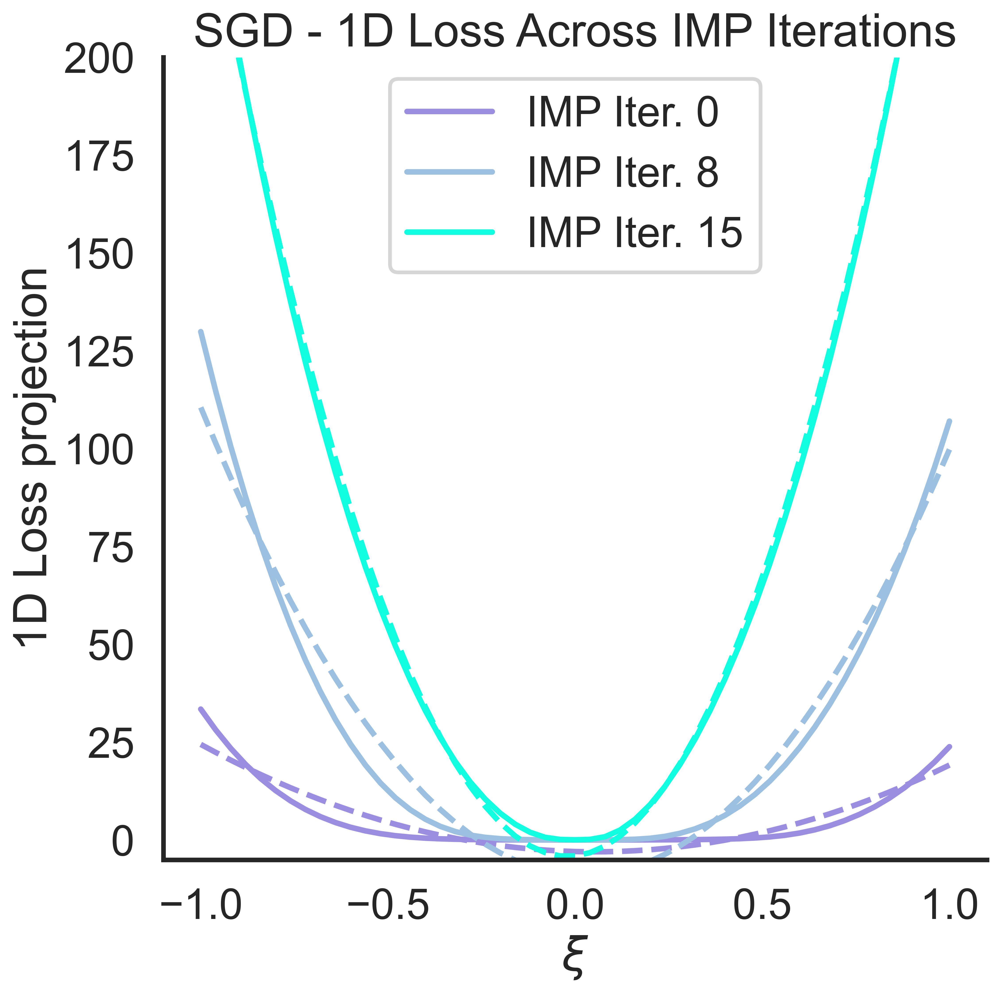

In [22]:
log_es = load_pkl_object("../experiments/mnist_project_fixed/extra/project_sgd_sgd.pkl")

fig, ax = plt.subplots(figsize=(8, 8))
cols = [(155/255, 142/255, 224/255), (155/255, 192/255, 224/255),(15/255, 255/255, 224/255),]

counter = 0
for i in [0, 8, 15]:
    ax.plot(xi, -log_es.mean(axis=0)[i, mid_point], label=f"IMP Iter. {i}", c=cols[counter])
    y = -log_es.mean(axis=0)[i, mid_point]
    coeffs = np.polyfit(xi, y, deg=2)
    fit = coeffs[0] * xi**2 + coeffs[1] * xi + coeffs[2]
    ax.plot(xi, fit, ls="--", c=cols[counter])
    counter += 1


ax.legend()
ax.set_ylim(-5, 200)
ax.set_xlabel(r"$\xi$")
ax.set_ylabel(r"1D Loss projection")
ax.set_title("SGD - 1D Loss Across IMP Iterations")
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

In [24]:
log_sgd = load_pkl_object("../experiments/mnist_project_fixed/extra/project_sgd_sgd.pkl")

all_coeffs_sgd = []
all_loss_sgd = []
for i in range(30):
    y = -log_sgd.mean(axis=0)[i, mid_point]
    coeffs = np.polyfit(xi, y, deg=2)
    all_coeffs_sgd.append(coeffs[0])
    all_loss_sgd.append(-log_sgd.mean(axis=0)[i, mid_point, mid_point])

log_es = load_pkl_object("../experiments/mnist_project_fixed/extra/project_es_es.pkl")

all_coeffs_es = []
all_loss_es = []
for i in range(30):
    y = -log_es.mean(axis=0)[i, 5]
    coeffs = np.polyfit(xi, y, deg=2)
    all_coeffs_es.append(coeffs[0])
    all_loss_es.append(-log_es.mean(axis=0)[i, mid_point, mid_point])

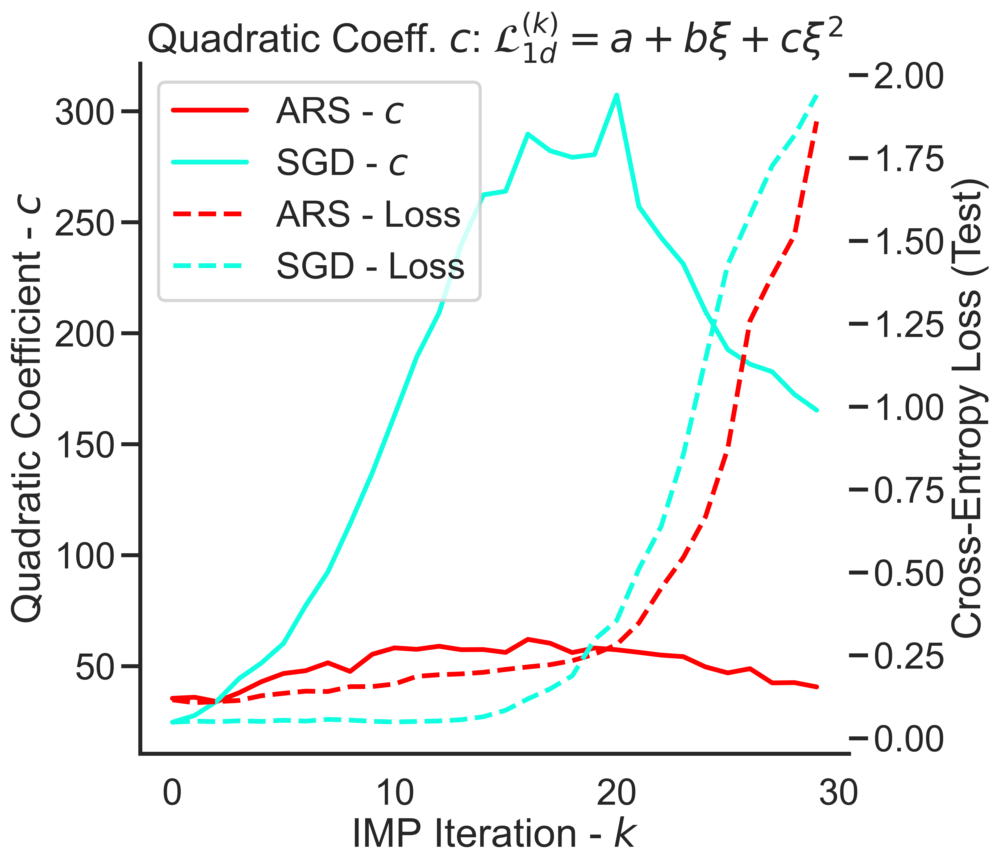

In [25]:

colors = ["red",
          (15/255, 255/255, 224/255),]

fig, ax = plt.subplots(figsize=(8, 8))
ln1 = ax.plot(all_coeffs_es, label=r"ARS - $c$", c=colors[0])
ln2 = ax.plot(all_coeffs_sgd, label=r"SGD - $c$", c=colors[1])

ax2=ax.twinx()
ln3 = ax2.plot(np.arange(30), all_loss_es, label="ARS - Loss", c=colors[0], ls="--")
ln4 = ax2.plot(np.arange(30), all_loss_sgd, label="SGD - Loss", c=colors[1], ls="--")

ax.set_title(r"Quadratic Coeff. $c$: $\mathcal{L}^{(k)}_{1d} = a + b \xi + c \xi^2$")
ax.set_xlabel(r"IMP Iteration - $k$")
ax.set_ylabel(r"Quadratic Coefficient - $c$")
ax2.set_ylabel(r"Cross-Entropy Loss (Test)")

lns = ln1 + ln2 + ln3 + ln4
labs = [l.get_label() for l in lns]
ax.legend(lns, labs, loc=0)

ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)
ax2.spines["top"].set_visible(False)
